## Initial setup

In [ ]:
#@title Install the required libs
!pip install -U -qq git+https://github.com/huggingface/diffusers.git
!pip install -qq accelerate tensorboard transformers ftfy gradio
!pip install -qq "ipywidgets>=7,<8"
!pip install -qq bitsandbytes

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
#@title Import required libraries
import argparse
import itertools
import math
import os
from contextlib import nullcontext
import random

import numpy as np
import torch
import torch.nn.functional as F
import torch.utils.checkpoint
from torch.utils.data import Dataset

import PIL
from accelerate import Accelerator
from accelerate.logging import get_logger
from accelerate.utils import set_seed
from diffusers import AutoencoderKL, DDPMScheduler, PNDMScheduler, StableDiffusionPipeline, UNet2DConditionModel
from diffusers.optimization import get_scheduler
from diffusers.pipelines.stable_diffusion import StableDiffusionSafetyChecker
from PIL import Image
from torchvision import transforms
from tqdm.auto import tqdm
from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer

import bitsandbytes as bnb

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

## Settings for teaching your new concept

In [ ]:
#`pretrained_model_name_or_path` which Stable Diffusion checkpoint you want to use
pretrained_model_name_or_path = "stabilityai/stable-diffusion-2" #["stabilityai/stable-diffusion-2", "stabilityai/stable-diffusion-2-base", "CompVis/stable-diffusion-v1-4", "runwayml/stable-diffusion-v1-5"]

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


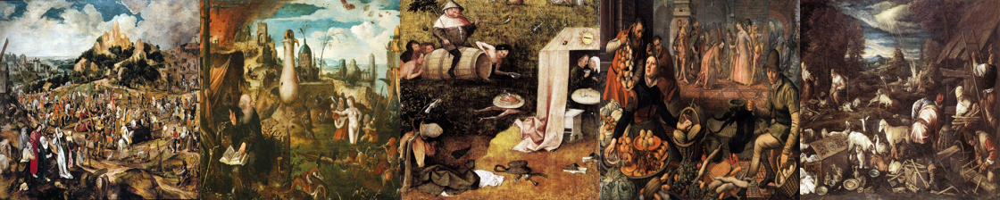

In [ ]:
# This is for running the generation separately from the retrieval, get retrieved images from google drive.

from PIL import Image
import os
import glob

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Set the folder path in your Google Drive where the images are stored
google_drive_folder = "/content/drive/MyDrive/train_images"  # Replace with your folder path

# Get all image file paths from the folder
image_paths = glob.glob(os.path.join(google_drive_folder, "*.png"))  # Adjust extension if needed

# Load images
def load_image(image_path):
    try:
        return Image.open(image_path).convert("RGB")
    except:
        return None

images = list(filter(None, [load_image(path) for path in image_paths]))

# Save the images locally (optional)
save_path = "./my_concept"
if not os.path.exists(save_path):
    os.mkdir(save_path)
[image.save(f"{save_path}/{i}.jpeg") for i, image in enumerate(images)]

# Display the images (requires the image_grid function)
image_grid(images, 1, len(images))  # Ensure `image_grid` is defined


In [ ]:
#@title Settings for your newly created concept
# `instance_prompt` is a prompt that should contain a good description of what your object or style is,
t8_new="a photo of an artwork of company meeting with people wearing black suits, using Renaissance-style depiction inspired by Leonardo da Vinci's works. Emphasize central perspective and symmetry. Incorporate dynamic compositions, vibrant colors, and symbolic details that reflect Leonardo’s innovative interpretation of the Gospel narrative"

t9_new = "a photo of an artwork of a joyful trip with Northern Renaissance-style inspired by the compositions of Pieter Bruegel the Elder, reinterpreted by Baltens. Emphasize intricate detail, narrative complexity, and vibrant scenes of everyday life. Incorporate dynamic groupings and a rich, textured atmosphere, reflecting the influence of Bruegel’s 1564 painting while showcasing Baltens’ distinct artistic vision and interpretation"

t1002_new = "a photo of an artwork of train carriage with Dutch Golden Age-inspired scene in the style of Pieter de Hooch, blending still-life qualities with precise perspective, and luminous colors. Capture a serene, frozen moment imbued with timelessness, where the interplay of light and structure evokes a sense of quiet eternity"




# a photo of a <cat-toy> toy

instance_prompt = f"{t9_new} in <sks> style"


# Check the `prior_preservation` option if you would like class of the concept (e.g.: toy, dog, painting) is guaranteed to be preserved. This increases the quality and helps with generalization at the cost of training time
prior_preservation = True
prior_preservation_class_prompt = "a photo of an artwork"

num_class_images = 12
sample_batch_size = 2
prior_loss_weight = 0.5
prior_preservation_class_folder = "./class_images"
class_data_root=prior_preservation_class_folder
class_prompt=prior_preservation_class_prompt

**Prior preservation** is a technique that uses additional images of the same class we are trying to train as part of the fine-tuning process. For example, if we try to incorporate a new person into the model, the class we'd want to preserve could be person.

By leveraging the semantic prior embedded in the model with a prior preservation loss, our technique enables synthesizing the subject in diverse scenes, poses, views and lighting conditions that do not appear in the reference images. For instance, such a prior learns to bind the word “dog” with various instances of dogs that can appear in different poses and contexts in an image.

Using prior preservation also helps preventing overfit.

#### Advanced settings for prior preservation (optional)

In [ ]:
num_class_images = 12
sample_batch_size = 2
# `prior_preservation_weight` determins how strong the class for prior preservation should be
prior_loss_weight = 1


# If the `prior_preservation_class_folder` is empty, images for the class will be generated with the class prompt. Otherwise, fill this folder with images of items on the same class as your concept (but not images of the concept itself)
prior_preservation_class_folder = "./class_images"
class_data_root=prior_preservation_class_folder

## Teach the model the new concept (fine-tuning with Dreambooth)
Execute this this sequence of cells to run the training process. The whole process may take from 15 min to 2 hours. (Open this block if you are interested in how this process works under the hood or if you want to change advanced training settings or hyperparameters)

In [ ]:
#@title Setup the Classes
from pathlib import Path
from torchvision import transforms

class DreamBoothDataset(Dataset):
    def __init__(
        self,
        instance_data_root,
        instance_prompt,
        tokenizer,
        class_data_root=None,
        class_prompt=None,
        size=512,
        center_crop=False,
    ):
        self.size = size
        self.center_crop = center_crop
        self.tokenizer = tokenizer

        self.instance_data_root = Path(instance_data_root)
        if not self.instance_data_root.exists():
            raise ValueError("Instance images root doesn't exists.")

        self.instance_images_path = list(Path(instance_data_root).iterdir())
        self.num_instance_images = len(self.instance_images_path)
        self.instance_prompt = instance_prompt
        self._length = self.num_instance_images

        if class_data_root is not None:
            self.class_data_root = Path(class_data_root)
            self.class_data_root.mkdir(parents=True, exist_ok=True)
            self.class_images_path = list(Path(class_data_root).iterdir())
            self.num_class_images = len(self.class_images_path)
            self._length = max(self.num_class_images, self.num_instance_images)
            self.class_prompt = class_prompt
        else:
            self.class_data_root = None

        self.image_transforms = transforms.Compose(
            [
                transforms.Resize(size, interpolation=transforms.InterpolationMode.BILINEAR),
                transforms.CenterCrop(size) if center_crop else transforms.RandomCrop(size),
                transforms.ToTensor(),
                transforms.Normalize([0.5], [0.5]),
            ]
        )

    def __len__(self):
        return self._length

    def __getitem__(self, index):
        example = {}
        instance_image = Image.open(self.instance_images_path[index % self.num_instance_images])
        if not instance_image.mode == "RGB":
            instance_image = instance_image.convert("RGB")
        example["instance_images"] = self.image_transforms(instance_image)
        example["instance_prompt_ids"] = self.tokenizer(
            self.instance_prompt,
            padding="do_not_pad",
            truncation=True,
            max_length=self.tokenizer.model_max_length,
        ).input_ids

        if self.class_data_root:
            class_image = Image.open(self.class_images_path[index % self.num_class_images])
            if not class_image.mode == "RGB":
                class_image = class_image.convert("RGB")
            example["class_images"] = self.image_transforms(class_image)
            example["class_prompt_ids"] = self.tokenizer(
                self.class_prompt,
                padding="do_not_pad",
                truncation=True,
                max_length=self.tokenizer.model_max_length,
            ).input_ids

        return example


class PromptDataset(Dataset):
    def __init__(self, prompt, num_samples):
        self.prompt = prompt
        self.num_samples = num_samples

    def __len__(self):
        return self.num_samples

    def __getitem__(self, index):
        example = {}
        example["prompt"] = self.prompt
        example["index"] = index
        return example

In [ ]:
#@title Generate Class Images (These will be generated only when prior_preservation is True)
import gc
if(prior_preservation):
    class_images_dir = Path(class_data_root)
    if not class_images_dir.exists():
        class_images_dir.mkdir(parents=True)
    cur_class_images = len(list(class_images_dir.iterdir()))

    if cur_class_images < num_class_images:
        pipeline = StableDiffusionPipeline.from_pretrained(
            pretrained_model_name_or_path, revision="fp16", torch_dtype=torch.float16
        ).to("cuda")
        pipeline.enable_attention_slicing()
        pipeline.set_progress_bar_config(disable=True)

        num_new_images = num_class_images - cur_class_images
        print(f"Number of class images to sample: {num_new_images}.")

        sample_dataset = PromptDataset(class_prompt, num_new_images)
        sample_dataloader = torch.utils.data.DataLoader(sample_dataset, batch_size=sample_batch_size)

        for example in tqdm(sample_dataloader, desc="Generating class images"):
            images = pipeline(example["prompt"]).images

            for i, image in enumerate(images):
                image.save(class_images_dir / f"{example['index'][i] + cur_class_images}.jpg")
        pipeline = None
        gc.collect()
        del pipeline
        with torch.no_grad():
          torch.cuda.empty_cache()

show generated class images

Displaying generated class images:


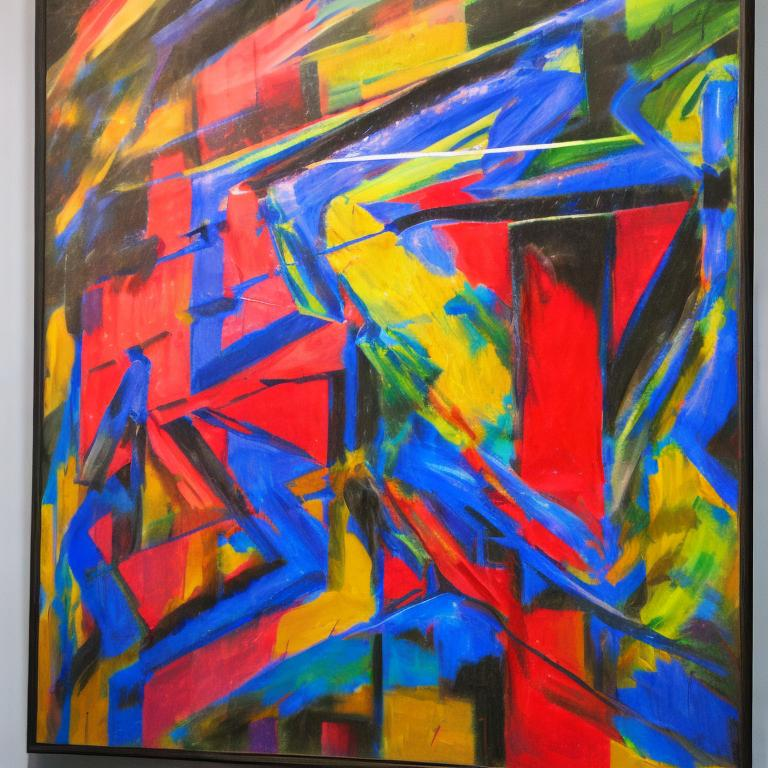

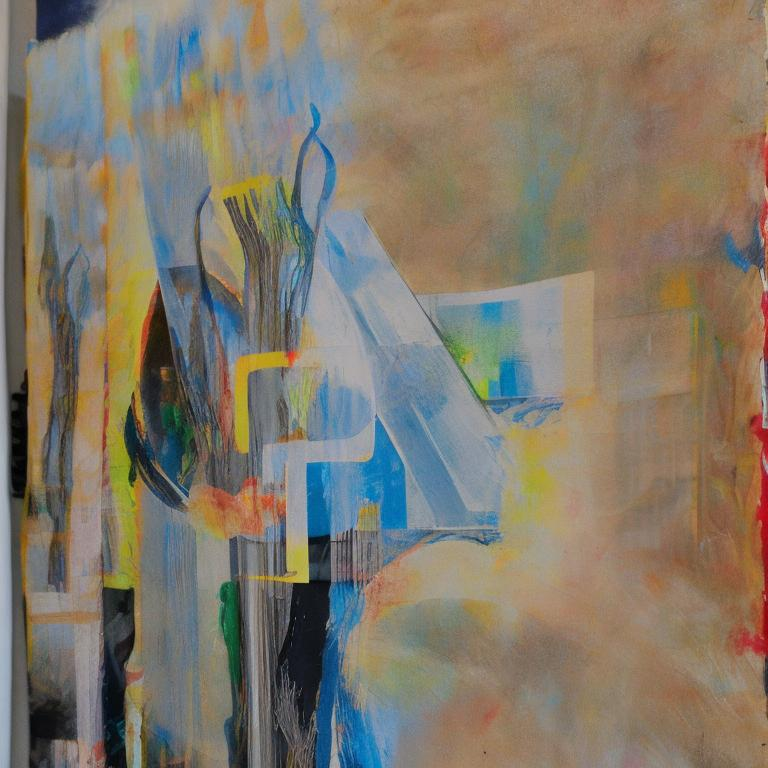

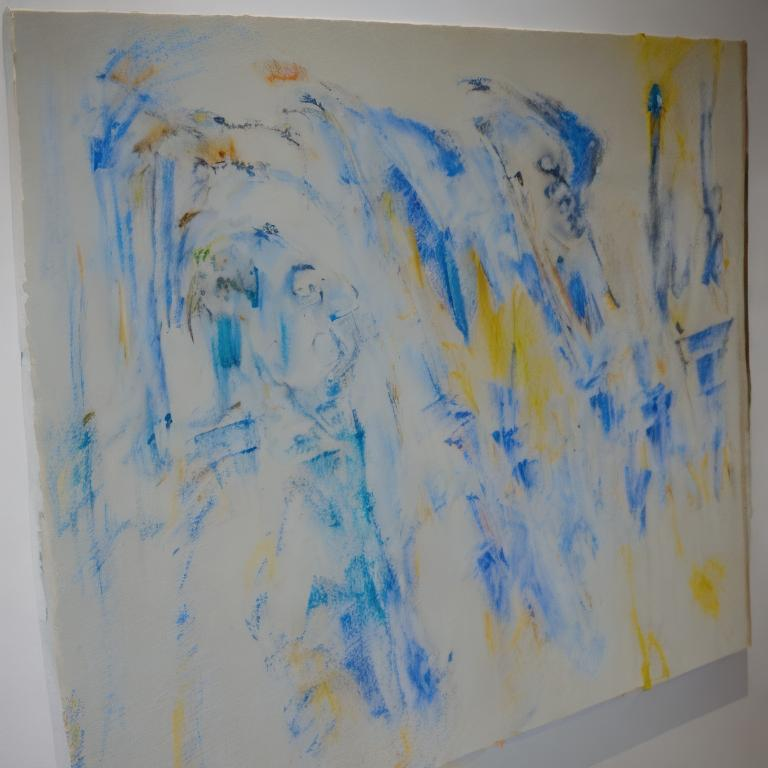

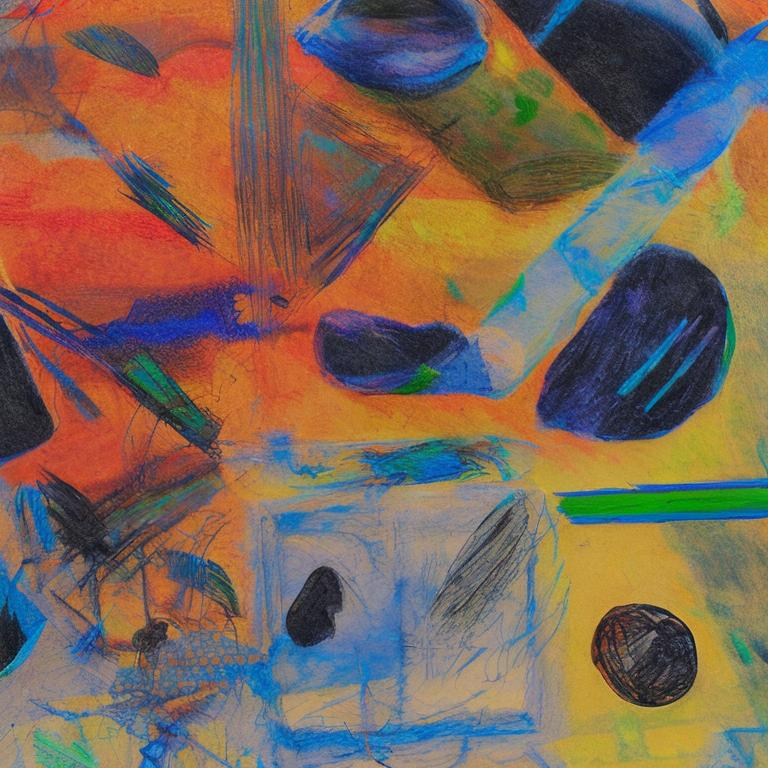

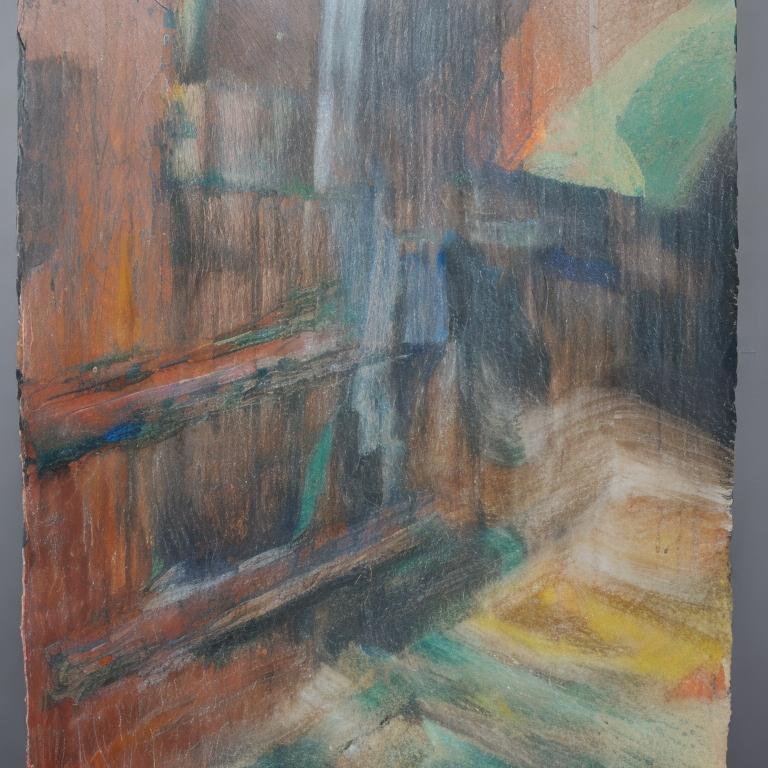

...

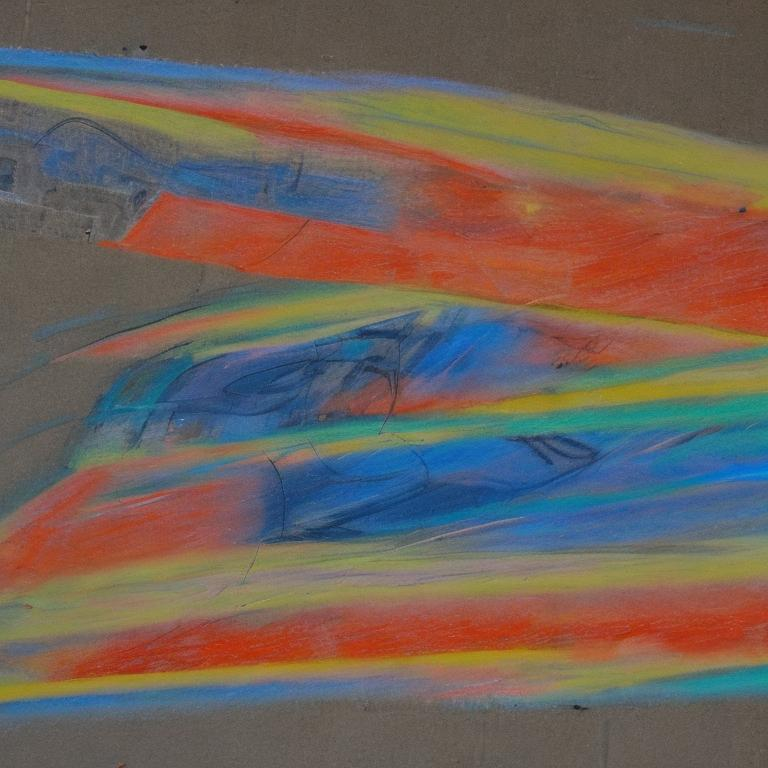

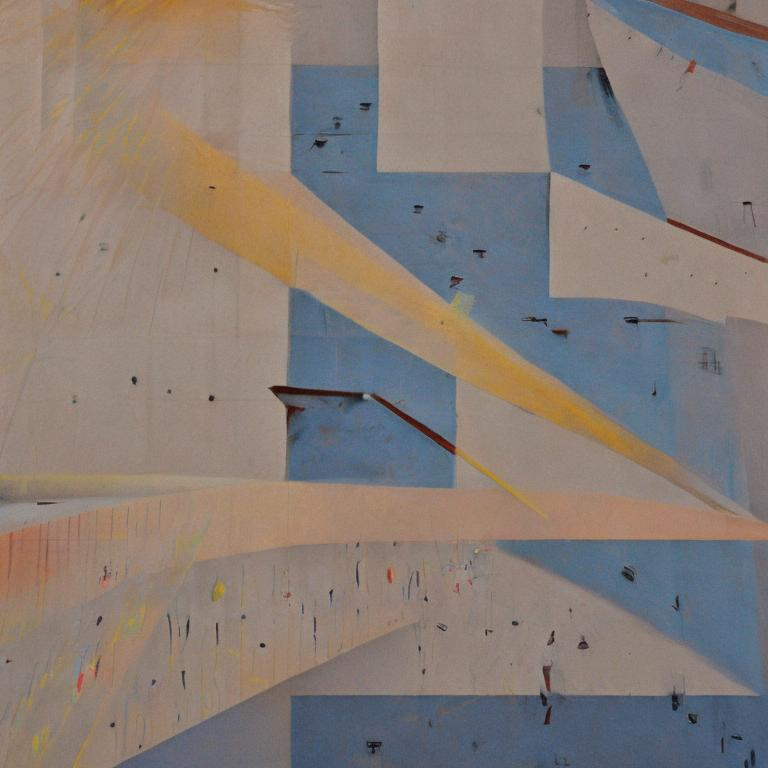

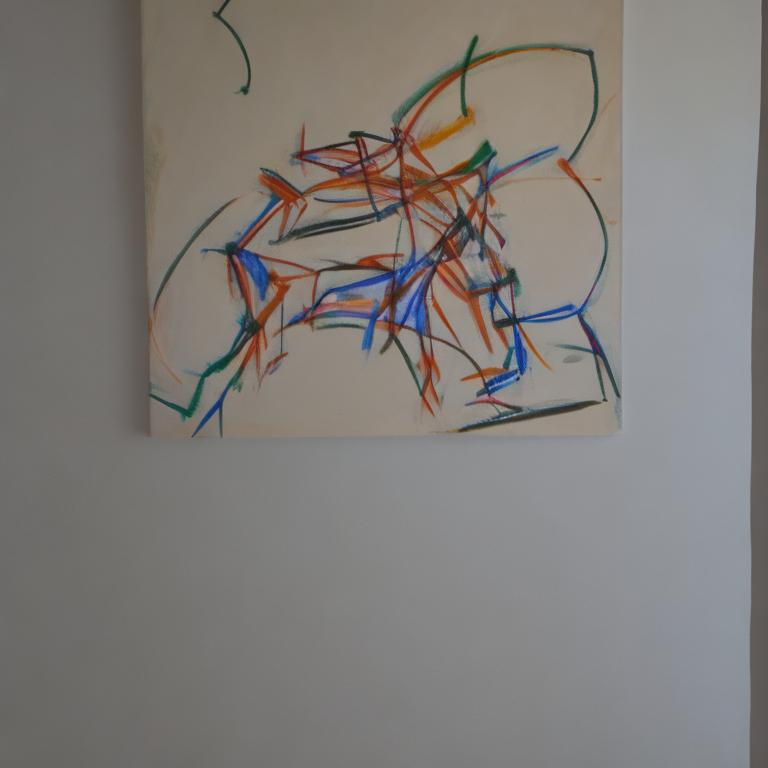

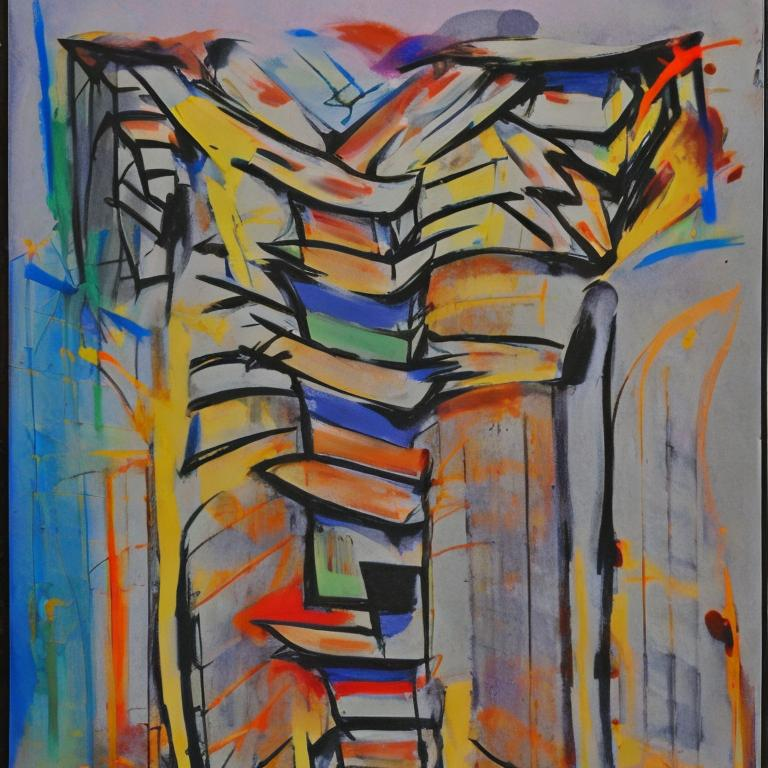

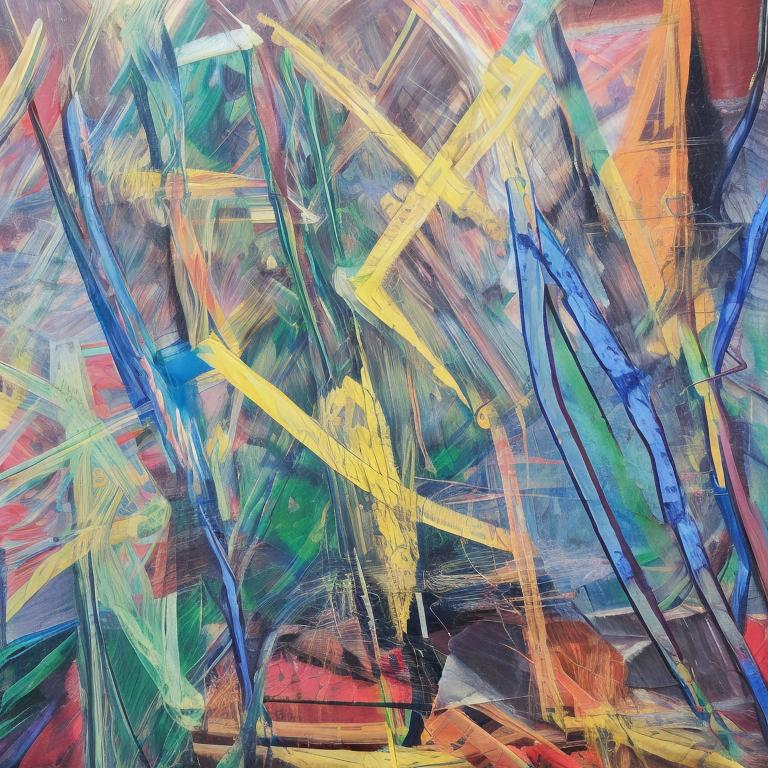

In [ ]:
from pathlib import Path
from PIL import Image
from IPython.display import display

# Path to the directory where class images are saved
class_images_dir = Path(class_data_root)

# Check if directory exists and display the images
if class_images_dir.exists() and any(class_images_dir.iterdir()):
    print("Displaying generated class images:")
    for image_path in sorted(class_images_dir.iterdir()):
        if image_path.suffix in [".jpg", ".png", ".jpeg"]:  # Check for image files
            image = Image.open(image_path)
            display(image)
else:
    print("No images found in the specified directory.")


In [ ]:
#@title Load the Stable Diffusion model
# Load models and create wrapper for stable diffusion

text_encoder = CLIPTextModel.from_pretrained(
    pretrained_model_name_or_path, subfolder="text_encoder"
)
vae = AutoencoderKL.from_pretrained(
    pretrained_model_name_or_path, subfolder="vae"
)
unet = UNet2DConditionModel.from_pretrained(
    pretrained_model_name_or_path, subfolder="unet"
)


# load my own trained model from google drive
# text_encoder = torch.load("/content/drive/MyDrive/db_trained_model/text_encoder_full.pt")
# vae = torch.load("/content/drive/MyDrive/db_trained_model/vae_full.pt")
# unet = torch.load("/content/drive/MyDrive/db_trained_model/unet_full.pt")

tokenizer = CLIPTokenizer.from_pretrained(
    pretrained_model_name_or_path,
    subfolder="tokenizer",
)

In [ ]:
#@title Setting up all training args
from argparse import Namespace
args = Namespace(
    pretrained_model_name_or_path=pretrained_model_name_or_path,
    resolution=vae.sample_size,
    center_crop=True,
    train_text_encoder=False,
    instance_data_dir=save_path,
    instance_prompt=instance_prompt,
    learning_rate=5e-06,
    max_train_steps=300,
    save_steps=50,
    train_batch_size=2, # set to 1 if using prior preservation
    gradient_accumulation_steps=2,
    max_grad_norm=1.0,
    mixed_precision="fp16", # set to "fp16" for mixed-precision training.
    gradient_checkpointing=True, # set this to True to lower the memory usage.
    use_8bit_adam=True, # use 8bit optimizer from bitsandbytes
    seed=3434554,
    with_prior_preservation=prior_preservation,
    prior_loss_weight=prior_loss_weight,
    sample_batch_size=2,
    class_data_dir=prior_preservation_class_folder,
    class_prompt=prior_preservation_class_prompt,
    num_class_images=num_class_images,
    lr_scheduler="constant",
    lr_warmup_steps=100,
    output_dir="dreambooth-concept",
)

<ipython-input-60-42244eda8d92>:5: FutureWarning: Accessing config attribute `sample_size` directly via 'AutoencoderKL' object attribute is deprecated. Please access 'sample_size' over 'AutoencoderKL's config object instead, e.g. 'unet.config.sample_size'.
  resolution=vae.sample_size,


**Adam** is an optimization algorithm that can be used instead of the classical stochastic gradient descent procedure to update network weights iterative based in training data.

In [ ]:
#@title Training function
from accelerate.utils import set_seed
def training_function(text_encoder, vae, unet):
    logger = get_logger(__name__)

    set_seed(args.seed)

    accelerator = Accelerator(
        gradient_accumulation_steps=args.gradient_accumulation_steps,
        mixed_precision=args.mixed_precision,
    )

    # Currently, it's not possible to do gradient accumulation when training two models with accelerate.accumulate
    # This will be enabled soon in accelerate. For now, we don't allow gradient accumulation when training two models.
    # TODO (patil-suraj): Remove this check when gradient accumulation with two models is enabled in accelerate.
    if args.train_text_encoder and args.gradient_accumulation_steps > 1 and accelerator.num_processes > 1:
        raise ValueError(
            "Gradient accumulation is not supported when training the text encoder in distributed training. "
            "Please set gradient_accumulation_steps to 1. This feature will be supported in the future."
        )

    vae.requires_grad_(False)
    if not args.train_text_encoder:
        text_encoder.requires_grad_(False)

    if args.gradient_checkpointing:
        unet.enable_gradient_checkpointing()
        if args.train_text_encoder:
            text_encoder.gradient_checkpointing_enable()

    # Use 8-bit Adam for lower memory usage or to fine-tune the model in 16GB GPUs
    if args.use_8bit_adam:
        optimizer_class = bnb.optim.AdamW8bit
    else:
        optimizer_class = torch.optim.AdamW

    params_to_optimize = (
        itertools.chain(unet.parameters(), text_encoder.parameters()) if args.train_text_encoder else unet.parameters()
    )

    optimizer = optimizer_class(
        params_to_optimize,
        lr=args.learning_rate,
    )

    noise_scheduler = DDPMScheduler.from_config(args.pretrained_model_name_or_path, subfolder="scheduler")

    train_dataset = DreamBoothDataset(
        instance_data_root=args.instance_data_dir,
        instance_prompt=args.instance_prompt,
        class_data_root=args.class_data_dir if args.with_prior_preservation else None,
        class_prompt=args.class_prompt,
        tokenizer=tokenizer,
        size=args.resolution,
        center_crop=args.center_crop,
    )

    def collate_fn(examples):
        input_ids = [example["instance_prompt_ids"] for example in examples]
        pixel_values = [example["instance_images"] for example in examples]

        # concat class and instance examples for prior preservation
        if args.with_prior_preservation:
            input_ids += [example["class_prompt_ids"] for example in examples]
            pixel_values += [example["class_images"] for example in examples]

        pixel_values = torch.stack(pixel_values)
        pixel_values = pixel_values.to(memory_format=torch.contiguous_format).float()

        input_ids = tokenizer.pad(
            {"input_ids": input_ids},
            padding="max_length",
            return_tensors="pt",
            max_length=tokenizer.model_max_length
        ).input_ids

        batch = {
            "input_ids": input_ids,
            "pixel_values": pixel_values,
        }
        return batch

    train_dataloader = torch.utils.data.DataLoader(
        train_dataset, batch_size=args.train_batch_size, shuffle=True, collate_fn=collate_fn
    )

    lr_scheduler = get_scheduler(
        args.lr_scheduler,
        optimizer=optimizer,
        num_warmup_steps=args.lr_warmup_steps * args.gradient_accumulation_steps,
        num_training_steps=args.max_train_steps * args.gradient_accumulation_steps,
    )

    if args.train_text_encoder:
        unet, text_encoder, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
            unet, text_encoder, optimizer, train_dataloader, lr_scheduler
        )
    else:
        unet, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
            unet, optimizer, train_dataloader, lr_scheduler
        )

    weight_dtype = torch.float32
    if accelerator.mixed_precision == "fp16":
        weight_dtype = torch.float16
    elif accelerator.mixed_precision == "bf16":
        weight_dtype = torch.bfloat16

    # Move text_encode and vae to gpu.
    # For mixed precision training we cast the text_encoder and vae weights to half-precision
    # as these models are only used for inference, keeping weights in full precision is not required.
    vae.to(accelerator.device, dtype=weight_dtype)
    vae.decoder.to("cpu")
    if not args.train_text_encoder:
        text_encoder.to(accelerator.device, dtype=weight_dtype)

    # We need to recalculate our total training steps as the size of the training dataloader may have changed.
    num_update_steps_per_epoch = math.ceil(len(train_dataloader) / args.gradient_accumulation_steps)
    num_train_epochs = math.ceil(args.max_train_steps / num_update_steps_per_epoch)

    # Train!
    total_batch_size = args.train_batch_size * accelerator.num_processes * args.gradient_accumulation_steps

    logger.info("***** Running training *****")
    logger.info(f"  Num examples = {len(train_dataset)}")
    logger.info(f"  Instantaneous batch size per device = {args.train_batch_size}")
    logger.info(f"  Total train batch size (w. parallel, distributed & accumulation) = {total_batch_size}")
    logger.info(f"  Gradient Accumulation steps = {args.gradient_accumulation_steps}")
    logger.info(f"  Total optimization steps = {args.max_train_steps}")
    # Only show the progress bar once on each machine.
    progress_bar = tqdm(range(args.max_train_steps), disable=not accelerator.is_local_main_process)
    progress_bar.set_description("Steps")
    global_step = 0

    for epoch in range(num_train_epochs):
        unet.train()
        for step, batch in enumerate(train_dataloader):
            with accelerator.accumulate(unet):
                # Convert images to latent space
                latents = vae.encode(batch["pixel_values"].to(dtype=weight_dtype)).latent_dist.sample()
                latents = latents * 0.18215

                # Sample noise that we'll add to the latents
                noise = torch.randn_like(latents)
                bsz = latents.shape[0]
                # Sample a random timestep for each image
                timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (bsz,), device=latents.device)
                timesteps = timesteps.long()

                # Add noise to the latents according to the noise magnitude at each timestep
                # (this is the forward diffusion process)
                noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

                # Get the text embedding for conditioning
                encoder_hidden_states = text_encoder(batch["input_ids"])[0]

                # Predict the noise residual
                noise_pred = unet(noisy_latents, timesteps, encoder_hidden_states).sample

                # Get the target for loss depending on the prediction type
                if noise_scheduler.config.prediction_type == "epsilon":
                    target = noise
                elif noise_scheduler.config.prediction_type == "v_prediction":
                    target = noise_scheduler.get_velocity(latents, noise, timesteps)
                else:
                    raise ValueError(f"Unknown prediction type {noise_scheduler.config.prediction_type}")

                if args.with_prior_preservation:
                    # Chunk the noise and noise_pred into two parts and compute the loss on each part separately.
                    noise_pred, noise_pred_prior = torch.chunk(noise_pred, 2, dim=0)
                    target, target_prior = torch.chunk(target, 2, dim=0)

                    # Compute instance loss
                    loss = F.mse_loss(noise_pred.float(), target.float(), reduction="none").mean([1, 2, 3]).mean()

                    # Compute prior loss
                    prior_loss = F.mse_loss(noise_pred_prior.float(), target_prior.float(), reduction="mean")

                    # Add the prior loss to the instance loss.
                    loss = loss + args.prior_loss_weight * prior_loss
                else:
                    loss = F.mse_loss(noise_pred.float(), target.float(), reduction="mean")

                accelerator.backward(loss)

                if accelerator.sync_gradients:
                    params_to_clip = (
                        itertools.chain(unet.parameters(), text_encoder.parameters())
                        if args.train_text_encoder
                        else unet.parameters()
                    )
                    accelerator.clip_grad_norm_(unet.parameters(), args.max_grad_norm)
                optimizer.step()
                optimizer.zero_grad()

            # Checks if the accelerator has performed an optimization step behind the scenes
            if accelerator.sync_gradients:
                progress_bar.update(1)
                global_step += 1

                if global_step % args.save_steps == 0:
                    if accelerator.is_main_process:
                        pipeline = StableDiffusionPipeline.from_pretrained(
                            args.pretrained_model_name_or_path,
                            unet=accelerator.unwrap_model(unet),
                            text_encoder=accelerator.unwrap_model(text_encoder),
                        )
                        save_path = os.path.join(args.output_dir, f"checkpoint-{global_step}")
                        pipeline.save_pretrained(save_path)

            logs = {"loss": loss.detach().item()}
            progress_bar.set_postfix(**logs)

            if global_step >= args.max_train_steps:
                break

        accelerator.wait_for_everyone()

    # Create the pipeline using the trained modules and save it.
    if accelerator.is_main_process:
        pipeline = StableDiffusionPipeline.from_pretrained(
            args.pretrained_model_name_or_path,
            unet=accelerator.unwrap_model(unet),
            text_encoder=accelerator.unwrap_model(text_encoder),
        )
        pipeline.save_pretrained(args.output_dir)

In [ ]:
#@title Run training
import accelerate
accelerate.notebook_launcher(training_function, args=(text_encoder, vae, unet))
for param in itertools.chain(unet.parameters(), text_encoder.parameters()):
  if param.grad is not None:
    del param.grad  # free some memory
  torch.cuda.empty_cache()

Launching training on one GPU.


/usr/local/lib/python3.10/dist-packages/diffusers/configuration_utils.py:245: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.If you were trying to load a scheduler, please use <class 'diffusers.schedulers.scheduling_ddpm.DDPMScheduler'>.from_pretrained(...) instead. Otherwise, please make sure to pass a configuration dictionary instead. This functionality will be removed in v1.0.0.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/300 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

## Run the code with your newly trained model
If you have just trained your model with the code above, use the block below to run it.

In [ ]:
#@title Set up the pipeline
from diffusers import DPMSolverMultistepScheduler
try:
    pipe
except NameError:
    pipe = StableDiffusionPipeline.from_pretrained(
        args.output_dir,
        scheduler = DPMSolverMultistepScheduler.from_pretrained(args.output_dir, subfolder="scheduler"),
        torch_dtype=torch.float16,
    ).to("cuda")

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["' distinct artistic vision and interpretation in < sks > style"]


  0%|          | 0/25 [00:00<?, ?it/s]

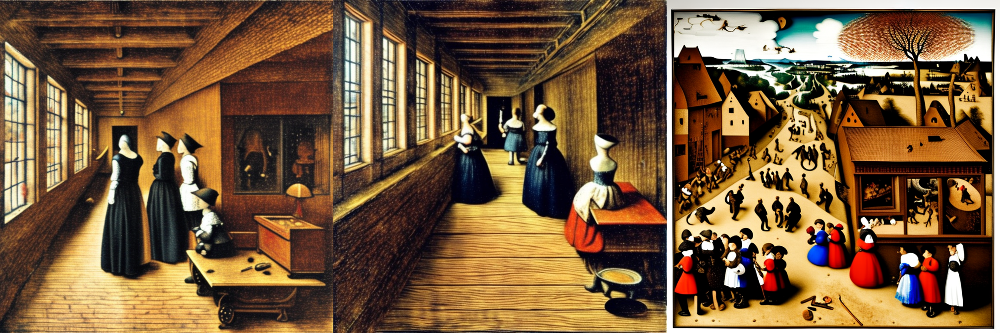

In [ ]:
#@title Run the Stable Diffusion pipeline on Colab
# Don't forget to use the placeholder token in your prompt

# prompt = f"{text} in <sks> style
prompt = instance_prompt

num_samples = 3
num_rows = 1

all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=25, guidance_scale=9).images
    all_images.extend(images)

grid = image_grid(all_images, num_rows, num_samples)
grid

# Step 1: Generate image with only text prompt

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained(pretrained_model_name_or_path, torch_dtype=torch.float16).to("cuda")

model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/345 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

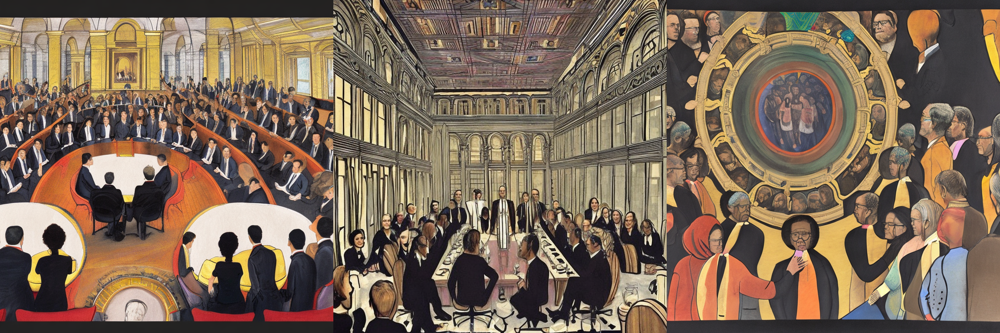

In [ ]:
from torch import autocast
# a photo of
t8_new="a photo of an artwork of company meeting with people wearing black suits, using Renaissance-style depiction inspired by Leonardo da Vinci's works. Emphasize central perspective and symmetry. Incorporate dynamic compositions, vibrant colors, and symbolic details that reflect Leonardo’s innovative interpretation of the Gospel narrative"
t8_old = """a photo of Leonardo's painting of the Last Supper was constructed symmetrically according to the laws of central perspective, with a main figure, Jesus, in the centre. He is physically and psychologically isolated from the other figures and with his hands is pointing to the bread and wine, making the introduction of the Eucharist the central event. In Leonardo's conception, the other figures are reacting directly to Jesus, and at the same time, some of them are coming into contact with each other.James the Great, whose mouth is opened in astonishment, is sitting on the right next to Jesus, and spreading out his arms as if trying to say to the two disciples behind him, who are attempting to command the attention of Jesus with their eloquent gestures and the way they are pushing forward, that they should be quiet and listen.James the Less, the second from the left, places his hand on Peter's back, while Andrew next to him is still holding his hands before him and speaking, but his eyes are already seeking out Jesus. Peter and John are facing each other deep in conversation, just like the group of three on the far right who still seem to be animatedly discussing the previous announcement of the existence of a traitor.That this announcement has indeed already taken place is proven by the behaviour of John and Peter. In contrast with the usual manner of depiction, in which John is lying against Christ's chest, here Leonardo refers to the Gospel of St John (13:24): "Simon Peter therefore beckoned to him, that he should ask who it should be of whom he spake."By combining these two apostles into a group with Judas in this manner, Leonardo was distancing himself from the traditional scheme of depiction used for Last Suppers, according to which Peter and John sat to the right and left of Jesus. In contrast to the other apostles, however, he characterized them so clearly that they are identifiable to the observer. He identified Peter by means of the threatening dagger that he would, at dawn, use to cut off the ear of Malchus, one of the soldiers arresting Jesus.John, the favourite disciple, is wearing red and blue garments as is Jesus, and is seated at his right hand, the most honourable place. But Judas above all was clearly characterized by Leonardo, for he was not, as was customary, placed in the centre of the picture in front of the table, but placed amongst the row of disciples. He is identified by means of several motifs such as his reaching for the bread, the purse containing the reward for his treachery and the knocking over of a saltcellar, a sign of misfortune. Leonardo even formally expressed his isolation from the group by depicting him as the only one whose upper body is leaning against the table, shrinking back from Jesus"""

t9_new = "a photo of an artwork of a joyful trip with Northern Renaissance-style inspired by the compositions of Pieter Bruegel the Elder, reinterpreted by Baltens. Emphasize intricate detail, narrative complexity, and vibrant scenes of everyday life. Incorporate dynamic groupings and a rich, textured atmosphere, reflecting the influence of Bruegel’s 1564 painting while showcasing Baltens’ distinct artistic vision and interpretation"
t9_old = "a photo of Traditionally the painting was ascribed to Pieter Bruegel the Elder, however, now Baltens' authorship is fully recognised. The composition was probably inspired, but only in the broadest of outlines, by Pieter Bruegel's painting of this subject, dated 1564, now in Vienna, Kunsthistorisches Museum, which Baltens must have known in Antwerp"

t1002_new = "a photo of an artwork of train carriage with Dutch Golden Age-inspired scene in the style of Pieter de Hooch, blending still-life qualities with precise perspective, and luminous colors. Capture a serene, frozen moment imbued with timelessness, where the interplay of light and structure evokes a sense of quiet eternity"
t1002_old = "a photo of Despite not belonging to the genre, de Hooch's paintings fit the description of still-life. Strictly constructed perspective, skilful chiaroscuro, and bright colours create a sense of frozen moment that encompasses eternity"




prompt = t8_new
num_samples = 1
num_rows = 3

all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=50, guidance_scale=7.5).images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid

# Save generated images

In [ ]:
import os
from PIL import Image

# Specify the folder path in Google Drive
save_path = ''
os.makedirs(save_path, exist_ok=True)

# Function to generate a unique file name
def get_unique_filename(base_path, base_name, ext):
    number = 1
    while True:
        file_name = f"{base_name}{number}{ext}"
        file_path = os.path.join(base_path, file_name)
        if not os.path.exists(file_path):
            return file_path
        number += 1

# Save images
for i in range(len(all_images)):
    # Generate a unique file name for each image
    img_path = get_unique_filename(save_path, "", ".jpg")

    # Convert to PIL Image if needed and save
    img = Image.fromarray(all_images[i]) if not isinstance(all_images[i], Image.Image) else all_images[i]
    img.save(img_path)

    print(f"Image saved: {img_path}")


# Save Model weights

In [ ]:
# Define save path in Google Drive
save_path = ""
os.makedirs(save_path, exist_ok=True)

# Save the trained model components
# torch.save(unet.state_dict(), f"{save_path}/unet.pt")
# torch.save(text_encoder.state_dict(), f"{save_path}/text_encoder.pt")
# torch.save(vae.state_dict(), f"{save_path}/vae.pt")

torch.save(unet, f"{save_path}/unet_full.pt")
torch.save(text_encoder, f"{save_path}/text_encoder_full.pt")
torch.save(vae, f"{save_path}/vae_full.pt")


print(f"Models saved successfully to {save_path}")


# Reloading the Model Later:

In [ ]:
# unet.load_state_dict(torch.load("/content/drive/MyDrive/trained_model/unet.pt"))
# text_encoder.load_state_dict(torch.load("/content/drive/MyDrive/trained_model/text_encoder.pt"))
# vae.load_state_dict(torch.load("/content/drive/MyDrive/trained_model/vae.pt"))


In [ ]:
unet = torch.load("/content/drive/MyDrive/db_trained_model/unet_full.pt")
text_encoder = torch.load("/content/drive/MyDrive/db_trained_model/text_encoder_full.pt")
vae = torch.load("/content/drive/MyDrive/db_trained_model/vae_full.pt")
